# Examples of milestone genes
Milestone genes (upregulated in a specific stage) were retrieved with different methods. Here are shown expressions of retrieved genes.

Heatmap titles show the relevant stages. Row titles (at the left of the heatmap) show number of genes and other parameters (e.g. padj and logFC used for filtering). Genes selected for different stages often overlap.

In [248]:
library(ComplexHeatmap)
library(circlize)
library(viridis)
library(proxy)
library(seriation)
library(dendextend)
options(repr.plot.width=38, repr.plot.height=38)
library(dplyr)

In [257]:
#**! Paths where expression data (average expression, expression patterns, expression height), strain order,
#** regulons clusters, and phenotipic data are saved
path_expression='/home/khrovatin/timeTrajectoriesNet/data/regulons/'
path_strain_order='/home/khrovatin/timeTrajectoriesNet/data/'
path_phenotypes = '/home/khrovatin/timeTrajectoriesNet/data/stages/'
path_impulse = '/home/khrovatin/timeTrajectoriesNet/data/stages/DE_across_stages/'
path_de='/home/khrovatin/timeTrajectoriesNet/data/deTime/stage_vs_other/'
path_classification='/home/khrovatin/timeTrajectoriesNet/data/stages/classification/'

In [250]:
#**! Specify file names for regulons and expression
#** Expression tab file: Genes in columns (already scaled), averaged strain data in rows, 
#** three additional comlumns: Time, Strain, and Group (meaning strain group)
avg_expression=read.table(paste(path_expression,"genes_averaged_orange_scale99percentileMax0.1.tsv",sep=''),
                          header=TRUE,row.names=1, sep="\t")

#**! Specify file names for phenotipic data
#** Phenotypes tab file: Short averaged sample names in rows (as in avg_expression) and columns with phenotypes.
#** Phenotypes should have values: yes, no, no data
avg_phenotype=read.table(paste(path_phenotypes,"averageStages.tsv",sep=''),
                          header=TRUE,row.names=1, sep="\t", stringsAsFactors=FALSE)
#Change avg_phenotypes data so that each phenotype can be coloured differently
avg_phenotype[avg_phenotype=='no']=NA
for(col in colnames(avg_phenotype)){
  new_col=avg_phenotype[col]
  new_col[new_col=='yes']=col
  avg_phenotype[col]=new_col
}


#** Strain order - single column with ordered strain names
strain_order<-as.vector(read.table(paste(path_strain_order,"strain_order.tsv",sep=''))[,1])

In [251]:
#** Some plotting parameters
legend_font=12
phenotypes_font=10
legened_height=1.5
legend_width=0.7
top_annotation_height=0.6
phenotype_annotation_height=3
cluster_font=20

In [252]:
make_anno<-function(){



#Strain groups annotation
#** Colours of strain groups
group_cols=c('agg-'= '#ed1c24', 'lag_dis'= '#f97402','tag_dis'='#ffb100', 'tag'='#d9d800', 'cud'= '#008629', 'WT'= '#00b2ff',
                        'sFB'= '#1925ae', 'prec'='#a400d4' )
#group_cols_background=c('agg-'= '#cccccc', 'lag_dis'= '#666666','tag_dis'='#666666', 'tag'='#666666', 'cud'= '#cccccc', 
#                        'WT'= '#cccccc','sFB'= '#cccccc', 'prec'='#cccccc' )
group_cols_background=c('agg-'= 'white', 'lag_dis'= 'white','tag_dis'='#666666', 'tag'='#666666', 'cud'= 'white', 
                        'WT'= 'white','sFB'= 'white', 'prec'='white' )
group_cols_text=c('agg-'= 'black', 'lag_dis'= 'black','tag_dis'='black', 'tag'='black', 'cud'= '#eeeeee', 
                        'WT'= 'black','sFB'= '#eeeeee', 'prec'='#eeeeee' )

group_data=t(avg_expression['Group'])
rownames(group_data)<-c('Phenotypic group')            
# ht_list=Heatmap(group_data,show_column_names = FALSE, 
#                 height = unit(top_annotation_height, "cm"),
#                 column_split=factor(avg_expression$Strain,
#                                     #** Ordering of the strains in the heatmap (a vector of strain names)
#                                     #levels=unique(avg_expression$Strain)
#                                     levels=strain_order
#                 ),
#                 cluster_columns=FALSE,name='\nPhenotypic \ngroup\n',
#                 #** Strain name font size
#                 column_title_gp=gpar(fontsize=legend_font),
#                 col=group_cols, heatmap_legend_param = list( 
#                 grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
#                 labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
#                 row_names_gp = gpar(fontsize = cluster_font))

#Time annotation
times=unique(avg_expression$Time)
#** Time colours, group colours, and gaps
group_cols_ordered=c()
groups_ordered=c()
background_cols_ordered=c()
text_cols_ordered=c()
gaps=c()
previous_group=NULL
for(strain in strain_order){
  group=as.character(avg_expression[avg_expression$Strain==strain,'Group'][1])
  #print(paste(strain,group,group_cols[group]))
  groups_ordered<-append(groups_ordered,group)
  group_cols_ordered<-append(group_cols_ordered,group_cols[group])
  background_cols_ordered<-append(background_cols_ordered,group_cols_background[group])
  text_cols_ordered<-append(text_cols_ordered,group_cols_text[group])
  #Gaps - if previous group was different add larger gap; (N gaps = N-1 columns)
  if (!is.null(previous_group)){
    if (previous_group==group){ 
      gaps=append(gaps,1)
    }else{
      gaps=append(gaps,2.5)
    }
  }
  previous_group=group
}
gaps=unit(gaps,'mm')

col_time = colorRamp2( c(min(times),max(times)),c( "white", "#440154FF"))

ht_list=Heatmap(t(avg_expression['Time']), height = unit(top_annotation_height, "cm"),
                column_split=factor(avg_expression$Strain,
                #** Ordering of the strains in the heatmap (a vector of strain names)
                levels=strain_order ),
                column_title =NULL,column_gap=gaps,
                cluster_columns=FALSE, show_column_names = FALSE,name='\nTime\n',col=col_time,
                heatmap_legend_param = 
                list( at = c(min(times),as.integer(mean(c(min(times),max(times)))),max(times)),
                grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)
                    ),
                row_names_gp = gpar(fontsize = cluster_font),
                #column_title_gp=gpar(border =group_cols_ordered,fontsize=cluster_font,col =text_cols_ordered,fill=group_cols_ordered,
                #                     fontface='bold'),
                #Annotation for Phenotype group
                top_annotation = HeatmapAnnotation(
                  Phenotype=anno_block(gp = 
                                         # Background colour; fill: color, col: border                               
                                         #gpar(fill = '#949494',col='transparent'),
                                         #gpar(fill = 'white',col='transparent'),
                                         #gpar(fill = background_cols_ordered,col='transparent'),
                                         #gpar(fill = group_cols_ordered,col=group_cols_ordered),
                                         gpar(fill=group_cols_ordered,col=group_cols_ordered,lwd =2,linejoin='mitre'),
                                       labels = groups_ordered , labels_gp = gpar(col = 
                                                                                    # Text colour
                                                                                    # 'black',
                                                                                    #group_cols_ordered, 
                                                                                    text_cols_ordered,
                                                                                  fontsize = cluster_font
                                                                                  #,fontface='bold'
                                       ),
                                       #show_name = TRUE
                                      ) ,
                  Strain = anno_block(gp = 
                                            # Background colour; fill: color, col: border                               
                                            #gpar(fill = '#949494',col='transparent'),
                                            #gpar(fill = 'white',col='transparent'),
                                            #gpar(fill = background_cols_ordered,col='transparent'),
                                            #gpar(fill = group_cols_ordered,col=group_cols_ordered),
                                              gpar(fill='white',col=group_cols_ordered,lwd =2,linejoin='mitre'),
                        labels = strain_order , labels_gp = gpar(col = 
                                                                    # Text colour
                                                                   'black',
                                                                    #group_cols_ordered, 
                                                                    #text_cols_ordered,
                                                                    fontsize = cluster_font
                                                                  #,fontface='bold'
                                                                  ), 
                                      #show_name = TRUE
                                     ),
                annotation_name_gp=gpar(fontsize = cluster_font)
                        )
                )
#ht_list=ht_list %v% ht_time

#Phenotype annotation
#** Colours of phenotype annotations
phenotype_cols=c('no image'= '#d9d9d9', 'no_agg'= '#ed1c24', 'stream'= '#985006', 'lag'= '#f97402', 'tag'= '#d9d800', 'tip'= '#66cf00',
  'slug'= '#008629', 'mhat'= '#00c58f', 'cul'= '#0ff2ff', 'FB'= '#00b2ff', 'yem'='#666666')
#phenotype_cols=c('no data'= '#d9d9d9', 'yes'= '#74cf19', 'no'='#b54c4c')
ht_phenotype=Heatmap(t(avg_phenotype)[,rownames(avg_expression)], height = unit(phenotype_annotation_height, "cm"),
                cluster_columns=FALSE,cluster_rows=FALSE, show_column_names = FALSE,name='\nMorphological \nstage\n',col=phenotype_cols,
                row_names_gp = gpar(fontsize = phenotypes_font), na_col = "white",
                row_title ='Morphological stage',row_title_side ='right',row_title_gp=gpar(fontsize = cluster_font),
                heatmap_legend_param = list( grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                                             labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)))
ht_list=ht_list %v% ht_phenotype
    
return(ht_list)
}

In [253]:
stage_order<-colnames(avg_phenotype)
expressions<-within(avg_expression, rm('Time', 'Strain','Group'))
min_expression<-min(expressions)
max_expression<-max(expressions)

## DE expression analysis (DESeq2)
Below shown genes were obtained by DE analysis of samples that were annotated with a certain stage against all other annotated samples. The design of all strains includes only comparison between stages. For the stages present in only some strains the reference (samples without the stage) still includes all availiable samples, including those of other strains. The design of WT includes also the replicate information as a confounder (thus including only replicates present both in case (the stage) and reference (other samples) data).

The data was filtered at two thresholds: padj<=0.01 + logFC>=2 and padj<=0.05 + logFC>=1 (excluding genes also retaind by the more stringent threshold). This is shown as row blocks in the heat maps. The row block names (at the left) denote which filtering method was used.

In [246]:
params_data<-data.frame(padj_max=c(0.01,0.05),lfc_min=c(2,1))

### All strains (DESeq2)

In [ ]:
for (stage in stage_order){
    #print(stage)
    if (file.exists(paste(path_de,'nobatchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''))){
    data=read.table(paste(path_de,'nobatchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''),
                    header=TRUE,sep='\t',row.names=1)
    first=TRUE
    heatmaps=make_anno()
    for(param_idx in 1:nrow(params_data)){
        padj=params_data[param_idx,'padj_max'] 
        lfc=params_data[param_idx,'lfc_min']
        genes<-rownames(data[data$log2FoldChange>=lfc & data$padj<=padj,])
        genes_previous=c()
        if (param_idx>1) genes_previous=rownames(data[data$log2FoldChange>=params_data[param_idx-1,'lfc_min'] 
             & data$padj<=params_data[param_idx-1,'padj_max'] ,])
        genes<-genes[which(!genes %in% genes_previous)]
        n_genes=length(genes)
        #print(paste(padj,lfc,n_genes))
        
        data_anno=paste('padj',padj,'lFC',lfc,'N',n_genes)
        height=0.5*n_genes
        if (height>40) height=40
        heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                        show_column_names = FALSE,
                          show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                          row_title=data_anno,
                          show_heatmap_legend = first,heatmap_legend_param = list(
                          title = "\nRelative \nexpression\n",
                          at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                          grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                          labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                          #** Cluster name fontsize
                          row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))
        first=FALSE
        heatmaps = heatmaps %v% heatmap
    }
    draw(heatmaps,width=unit(80, "cm"),
     column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))
    }
}

### WT (DESeq2)

In [ ]:
for (stage in stage_order){
    #print(stage)
    if (file.exists(paste(path_de,'WT_batchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''))){
    data=read.table(paste(path_de,'WT_batchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''),
                    header=TRUE,sep='\t',row.names=1)
    first=TRUE
    heatmaps=make_anno()
    for(param_idx in 1:nrow(params_data)){
        padj=params_data[param_idx,'padj_max'] 
        lfc=params_data[param_idx,'lfc_min']
        genes<-rownames(data[data$log2FoldChange>=lfc & data$padj<=padj,])
        genes_previous=c()
        if (param_idx>1) genes_previous=rownames(data[data$log2FoldChange>=params_data[param_idx-1,'lfc_min'] 
             & data$padj<=params_data[param_idx-1,'padj_max'] ,])
        genes<-genes[which(!genes %in% genes_previous)]
        n_genes=length(genes)
        #print(paste(padj,lfc,n_genes))
        
        data_anno=paste('padj',padj,'lFC',lfc,'N',n_genes)
        height=0.5*n_genes
        if (height>40) height=40
        heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                        show_column_names = FALSE,
                          show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                          row_title=data_anno,
                          show_heatmap_legend = first,heatmap_legend_param = list(
                          title = "\nRelative \nexpression\n",
                          at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                          grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                          labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                          #** Cluster name fontsize
                          row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))
        first=FALSE
        heatmaps = heatmaps %v% heatmap
    }
    draw(heatmaps,width=unit(80, "cm"),
     column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))
}
}

### DESeq2 WT/all overlap

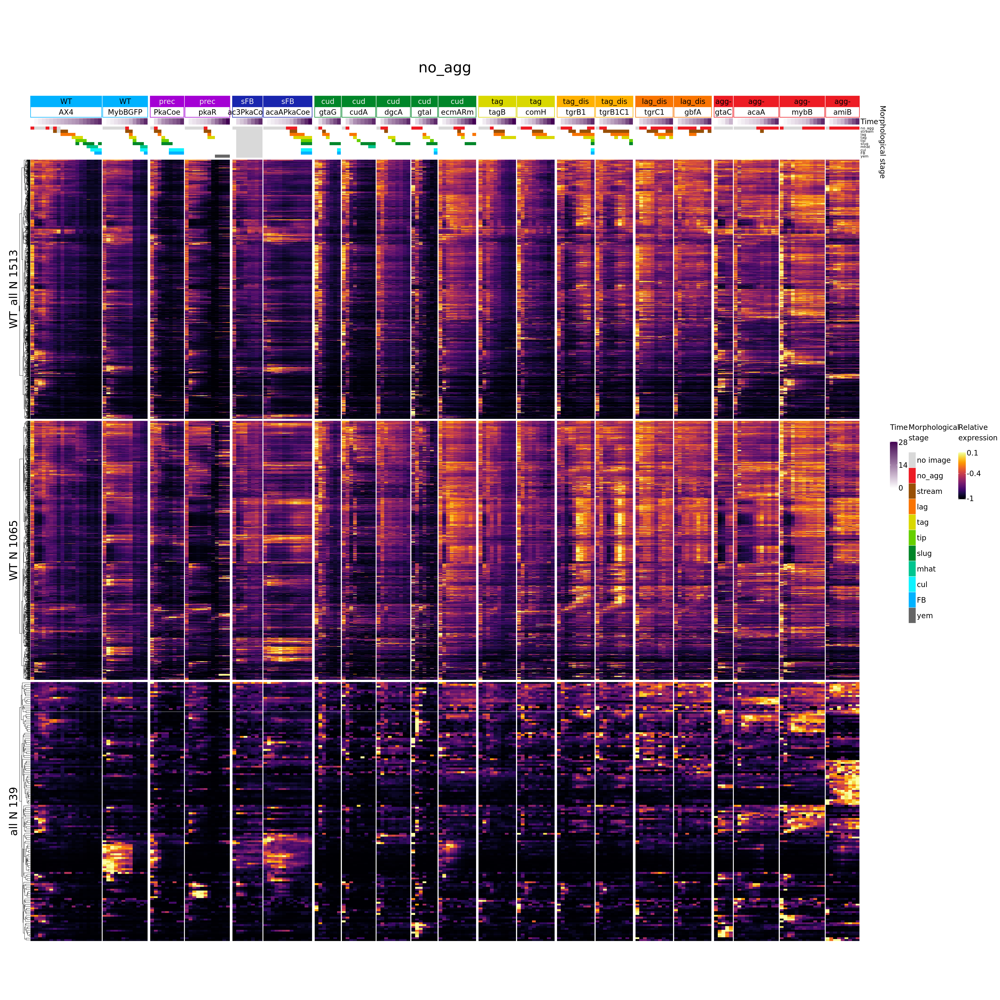

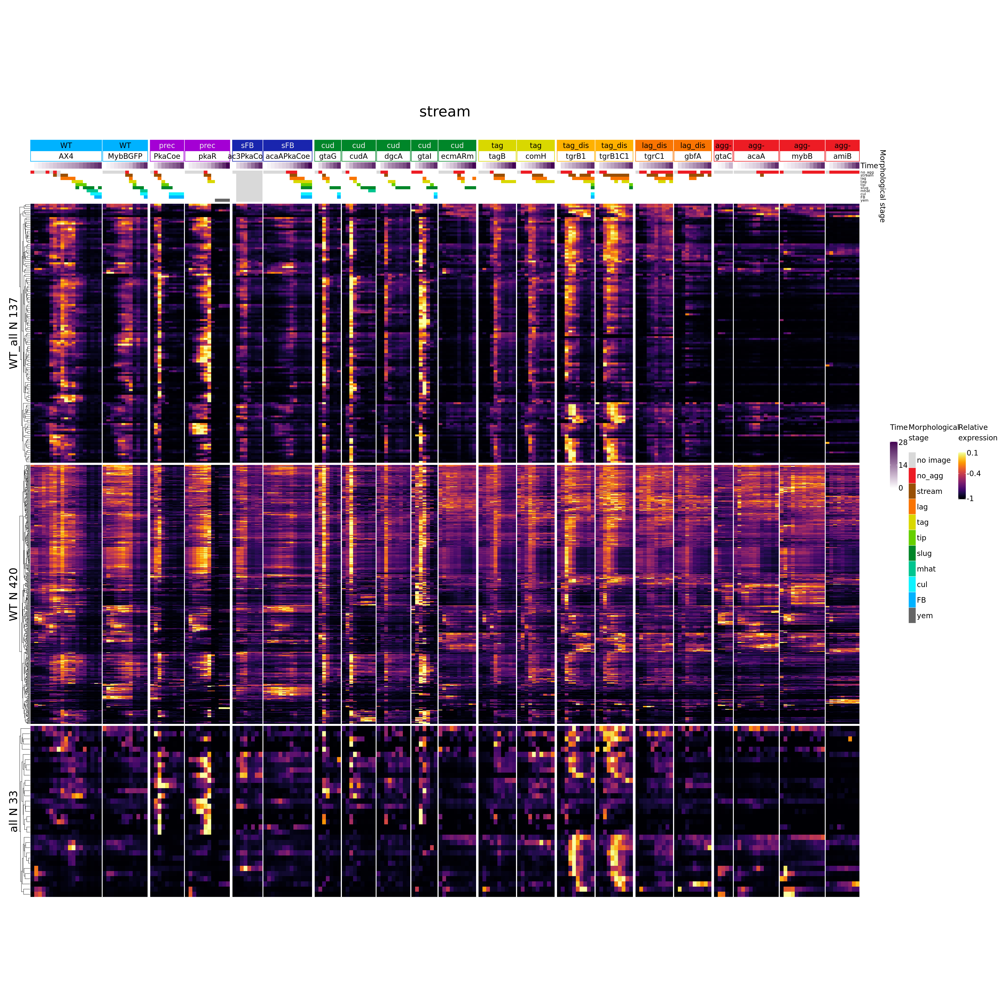

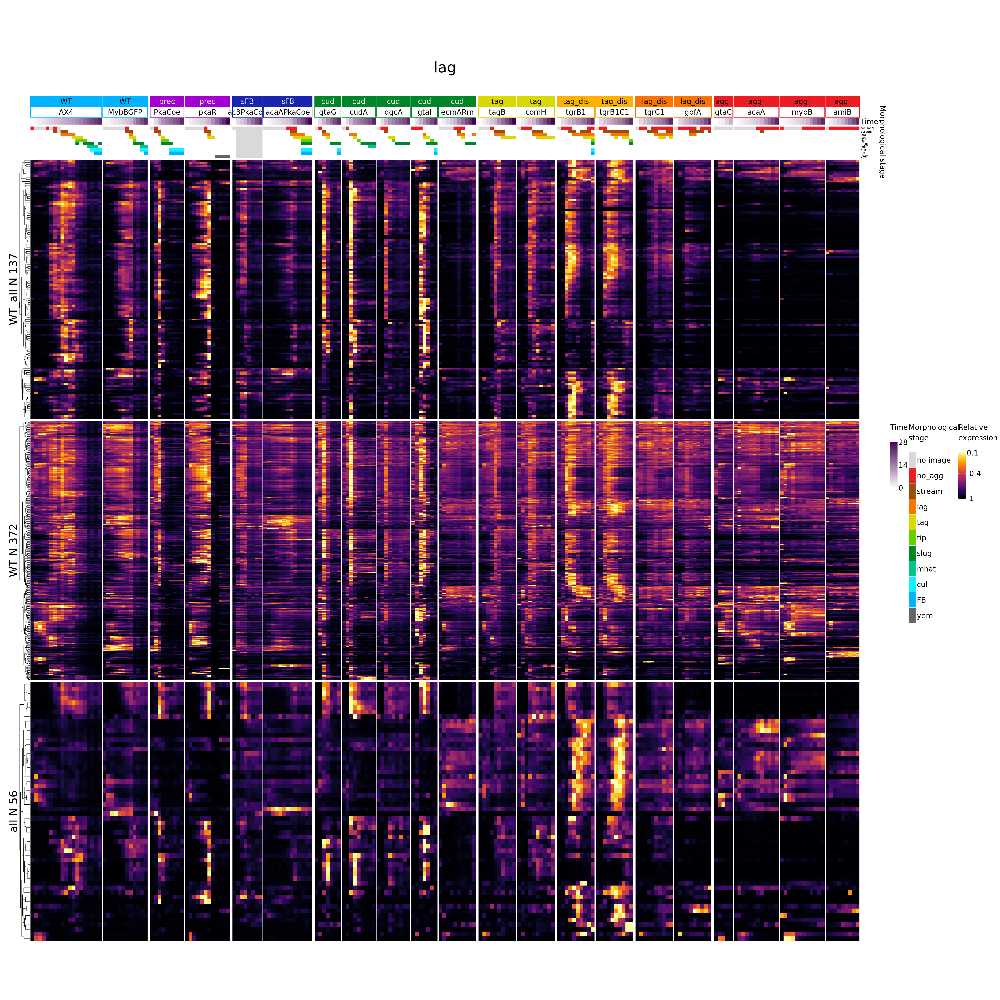

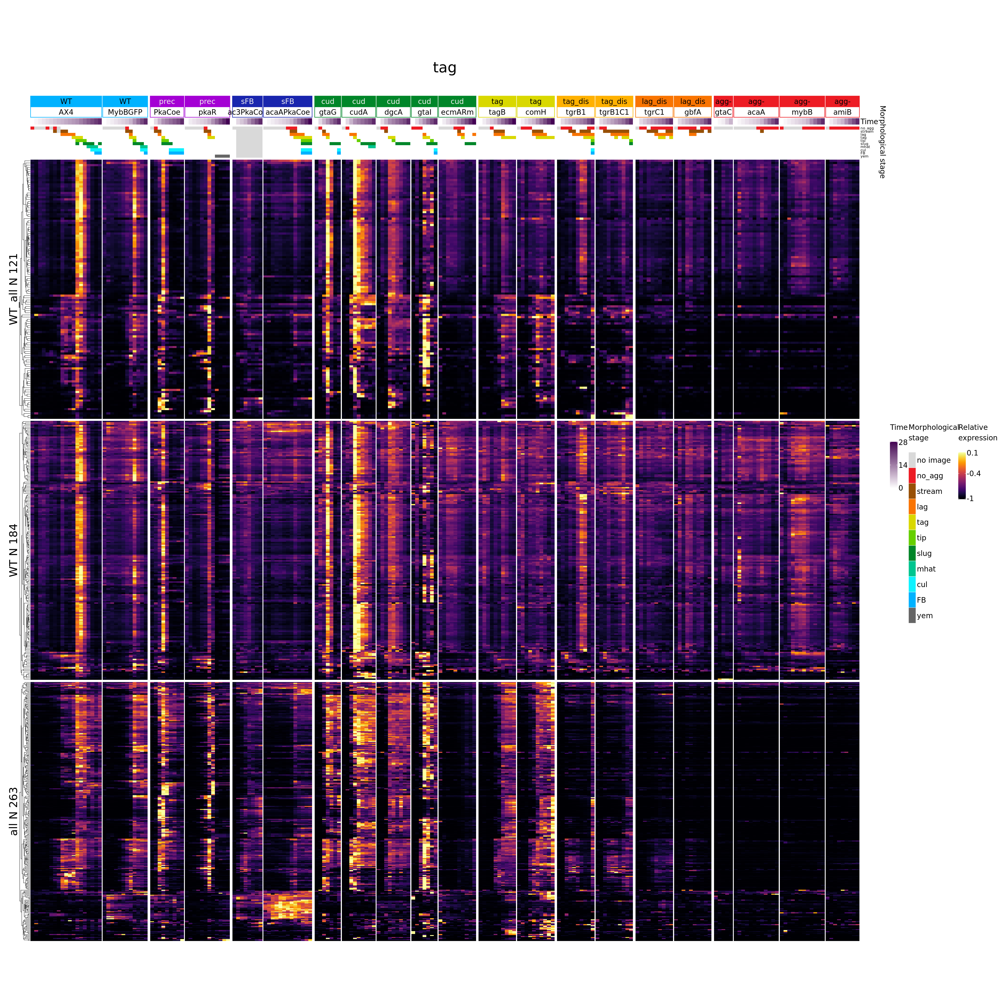

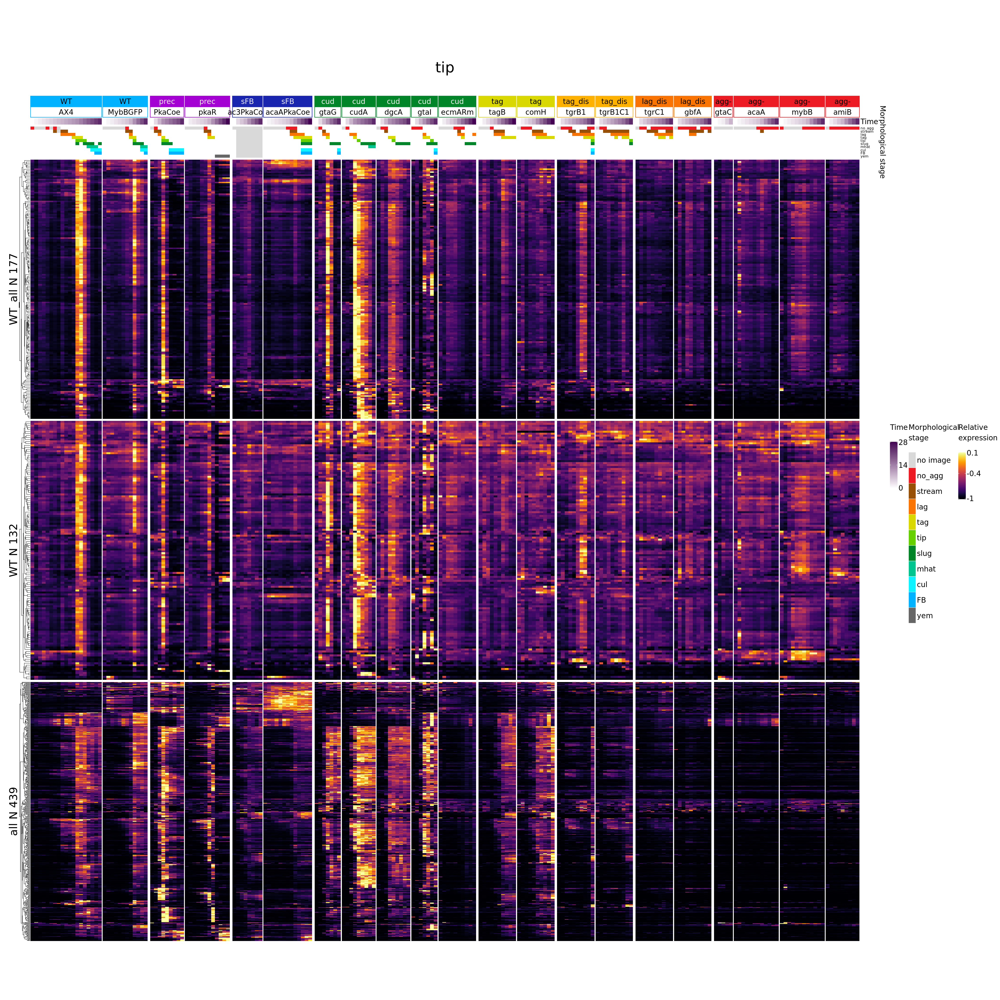

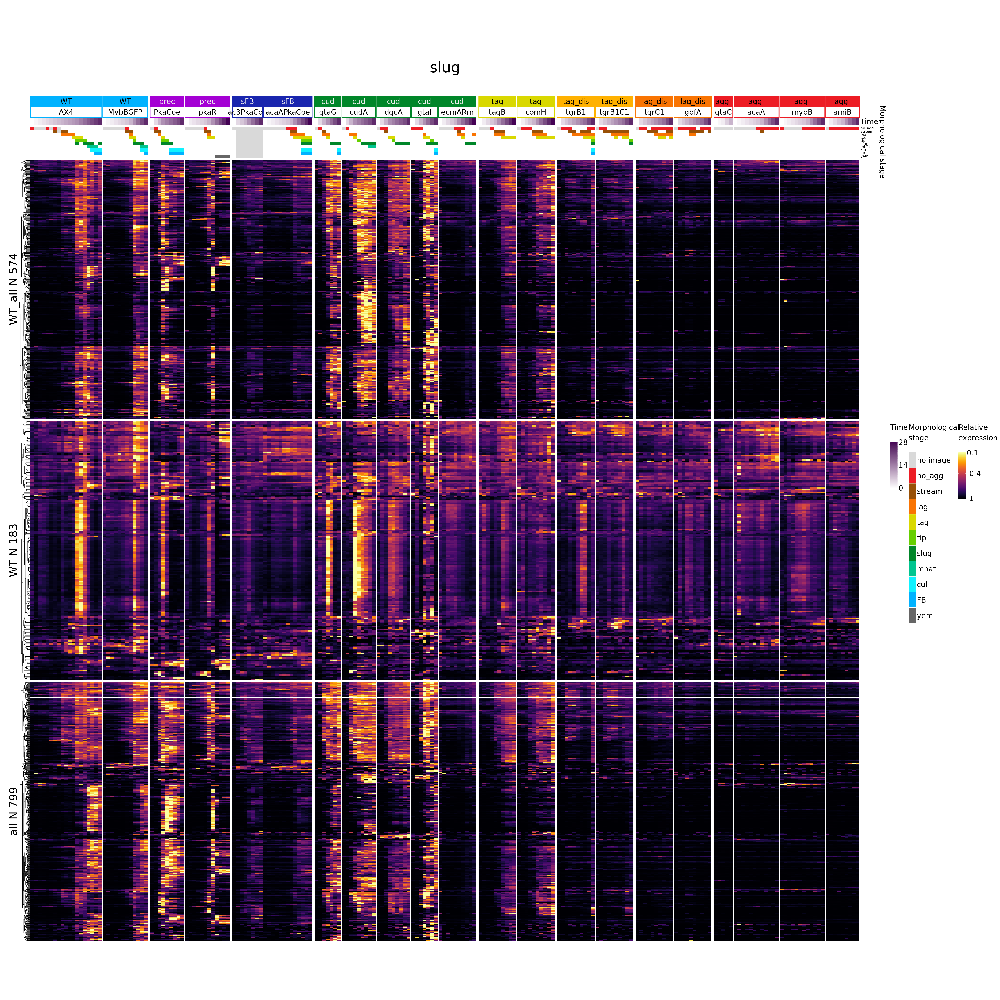

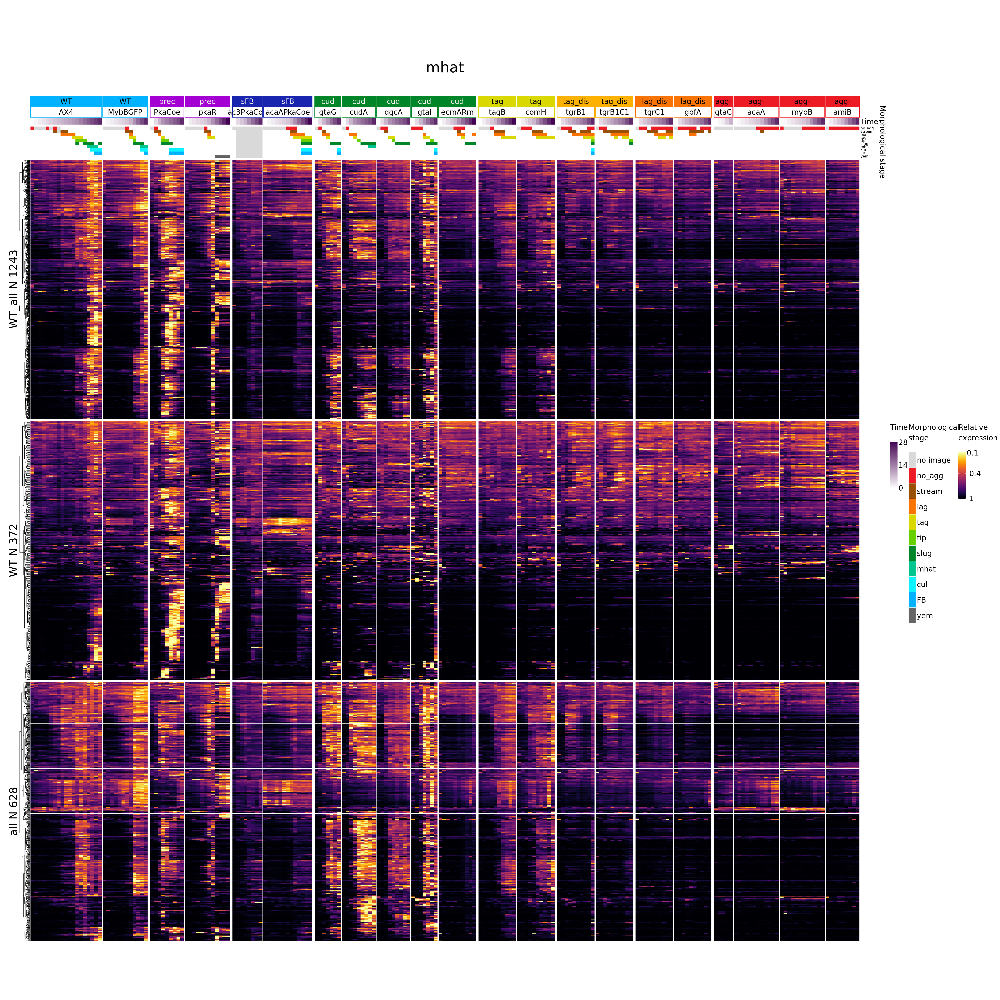

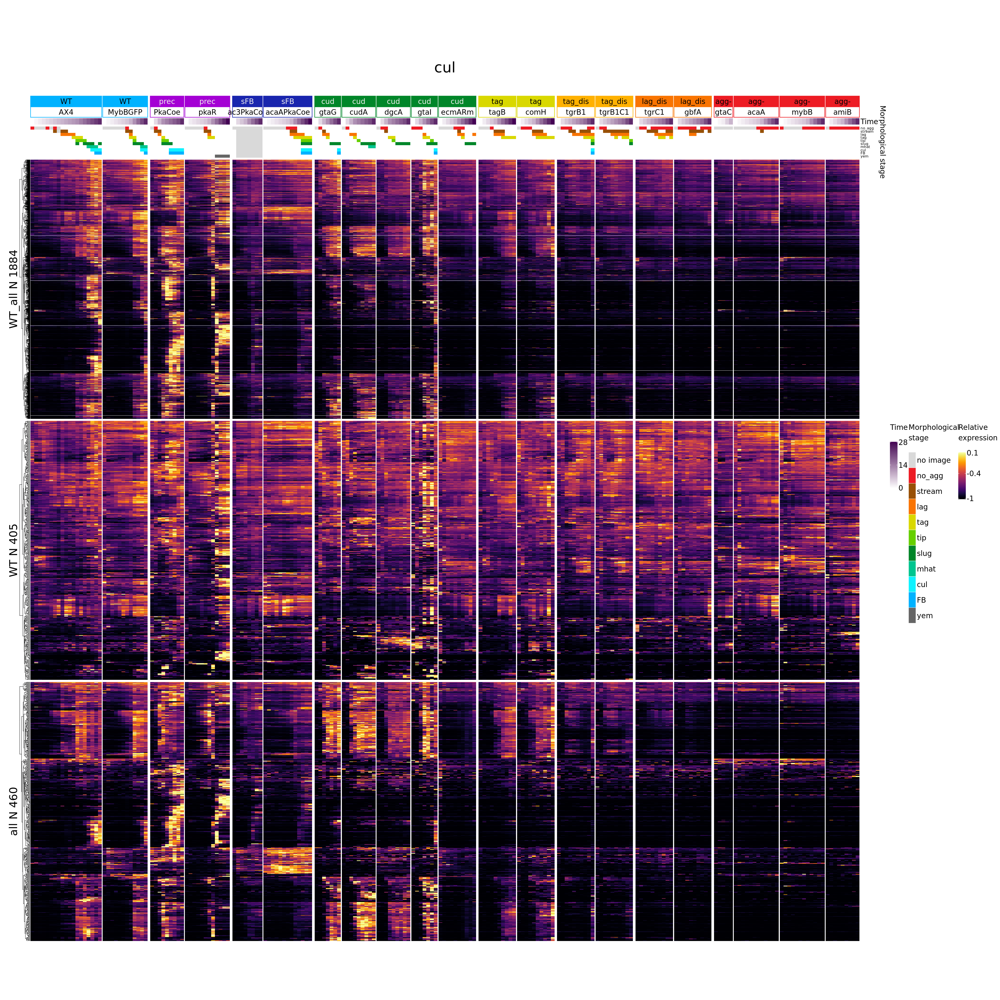

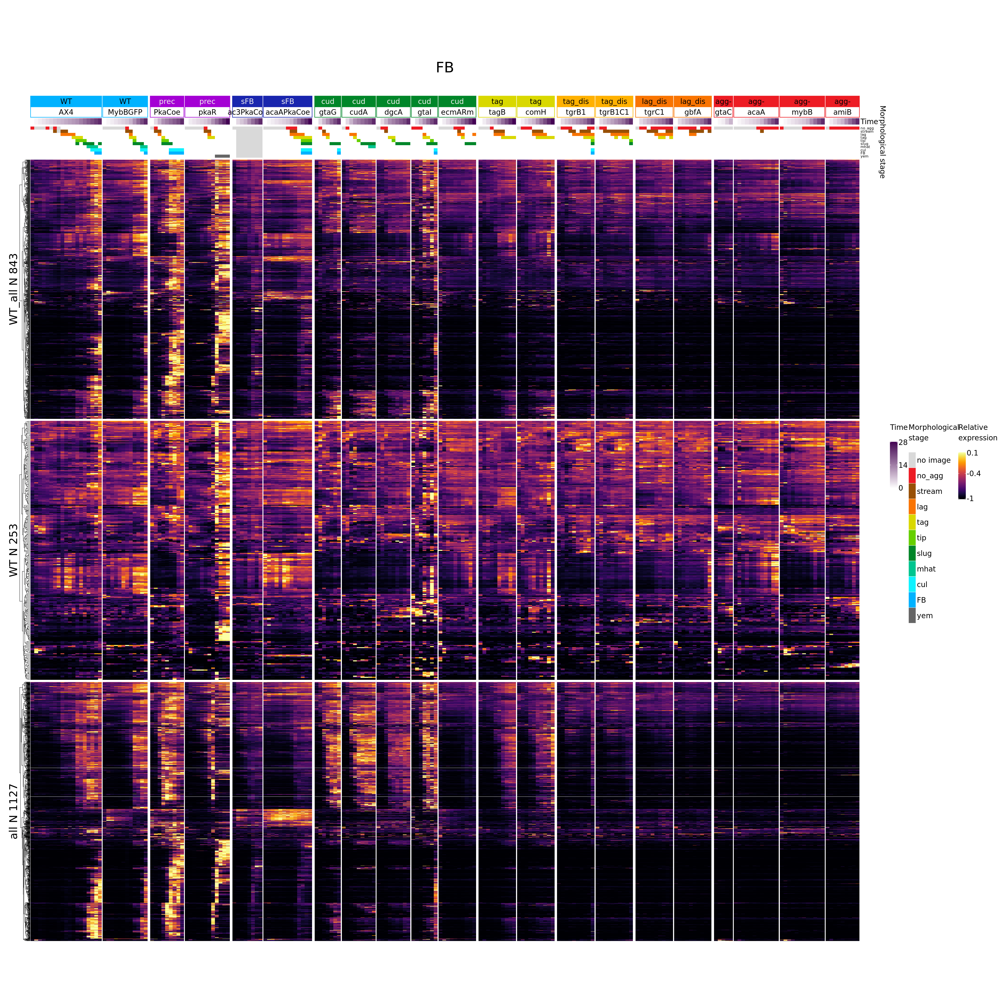

In [45]:
for (stage in stage_order){
#print(stage)
if (file.exists(paste(path_de,'nobatchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep='')) &
           file.exists(paste(path_de,'WT_batchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''))){
        data_all=read.table(paste(path_de,'nobatchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''),
                        header=TRUE,sep='\t',row.names=1)
        data_WT=read.table(paste(path_de,'WT_batchrep/DE_',stage,'_ref_other_padj0.05_lFC1.tsv',sep=''),
                        header=TRUE,sep='\t',row.names=1)
        genes_all<-rownames(data_all[data_all$log2FoldChange>=1 & data_all$padj<=0.05,])
        genes_WT<-rownames(data_WT[data_WT$log2FoldChange>=1 & data_WT$padj<=0.05,])
       genes_list <- vector(mode = "list")
        genes_list[['WT_all']]=intersect(genes_WT,genes_all)
        genes_list[['WT']]=setdiff(genes_WT,genes_all)
        genes_list[['all']]=setdiff(genes_all,genes_WT)
               
        first=TRUE
       heatmaps=make_anno()
        for(data_set in names(genes_list)){
            genes<-genes_list[[data_set]]
            n_genes=length(genes)
            #print(paste(data_set,n_genes))
            
            data_anno=paste(data_set,'N',n_genes)
            height=0.5*n_genes
            if (height>25) height=25
            heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                            show_column_names = FALSE,
                              show_row_names = FALSE, col=inferno(256),column_title=NULL,
                              row_title=data_anno,
                              show_heatmap_legend = first,heatmap_legend_param = list(
                              title = "\nRelative \nexpression\n",
                              at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                              grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                              labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                              #** Cluster name fontsize
                              row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))
            first=FALSE
            heatmaps = heatmaps %v% heatmap
        }
        draw(heatmaps,width=unit(80, "cm"),
         column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))
        }
    }

### DESeq2 combined results from individual strains
DESeq2 was performed on individual strains and result was latter combined with Stouffer method for combining pvalues. The test were performed adjusting for replicates and testing for lFC>0.5 (so that the filtering by lFC is not needed on the combined data). Only stages that had at least 2 replicates in both query and reference group were used for testing in individual strains. 

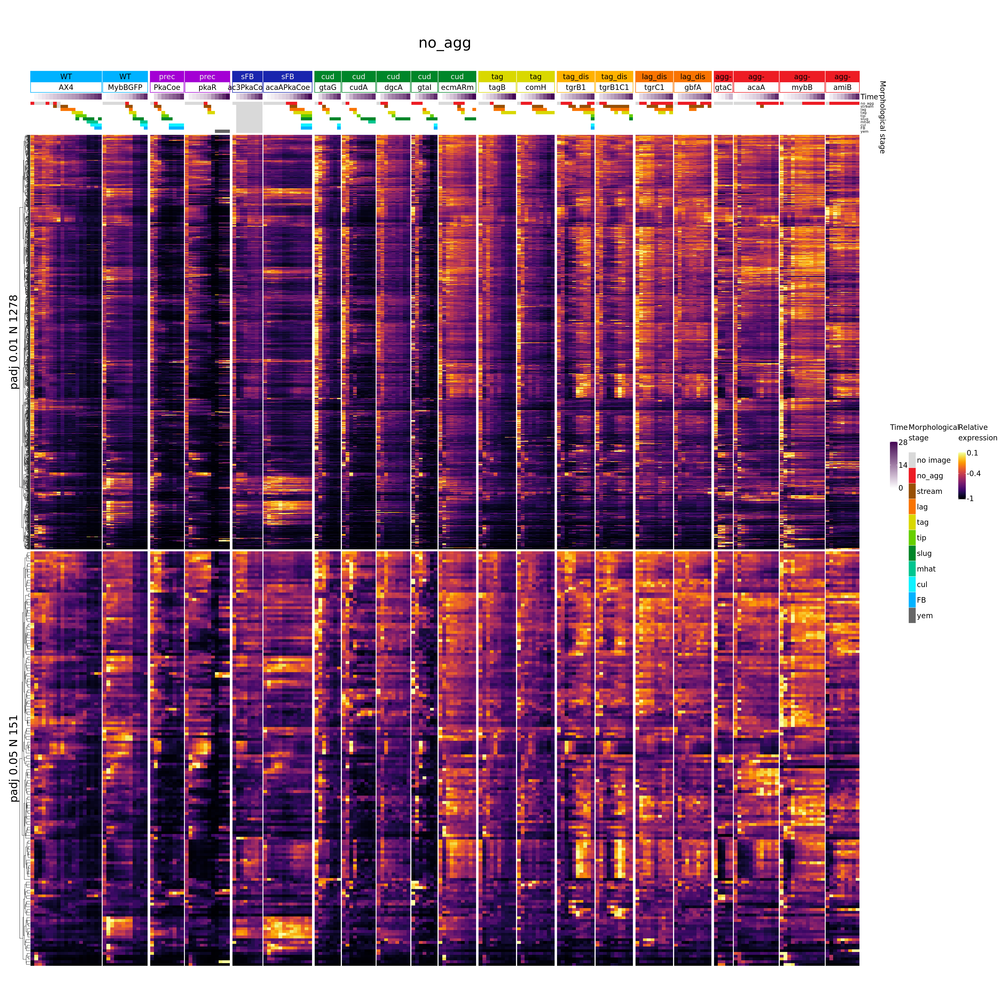

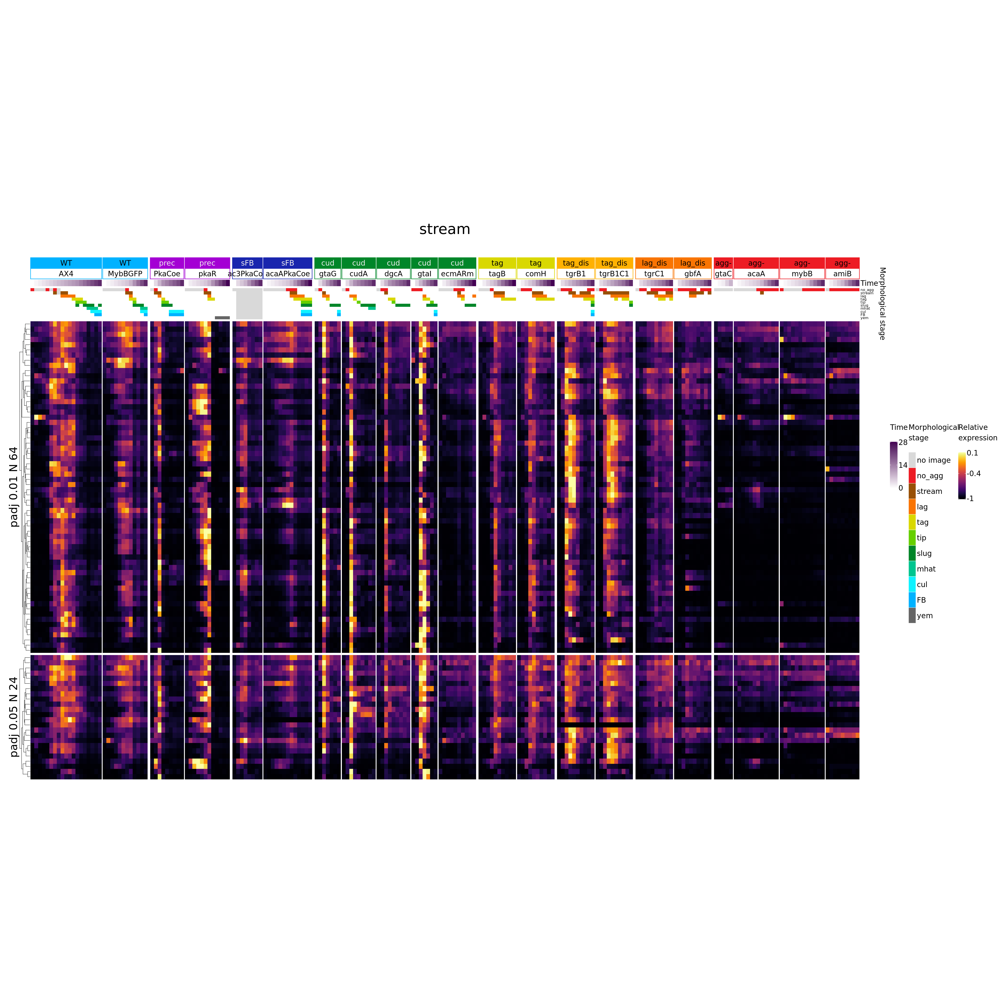

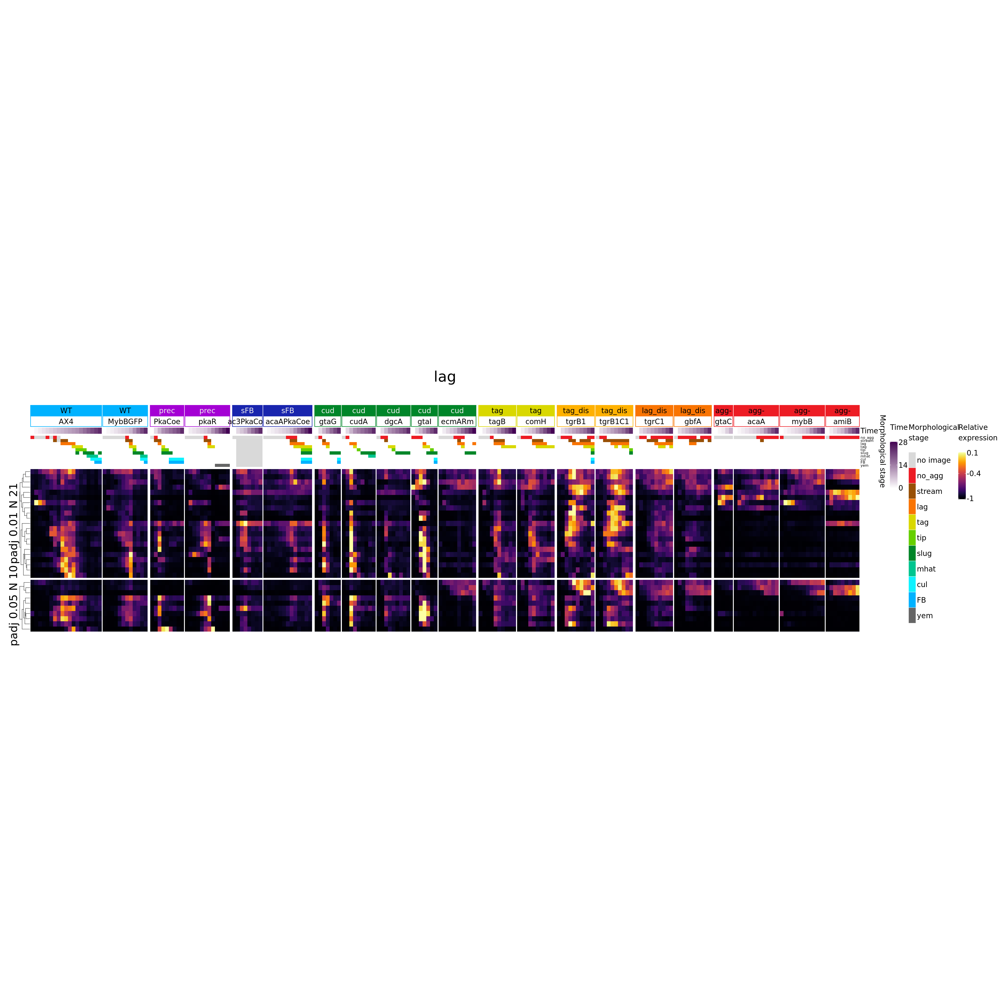

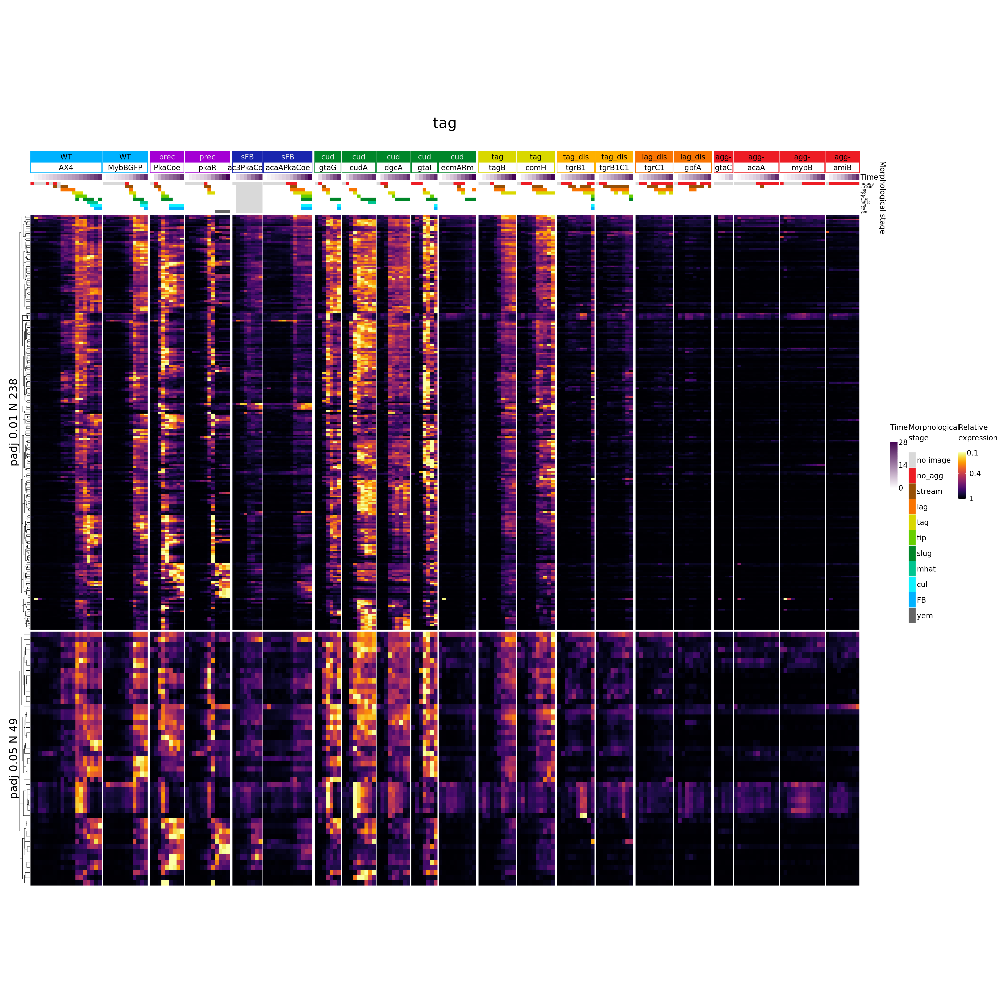

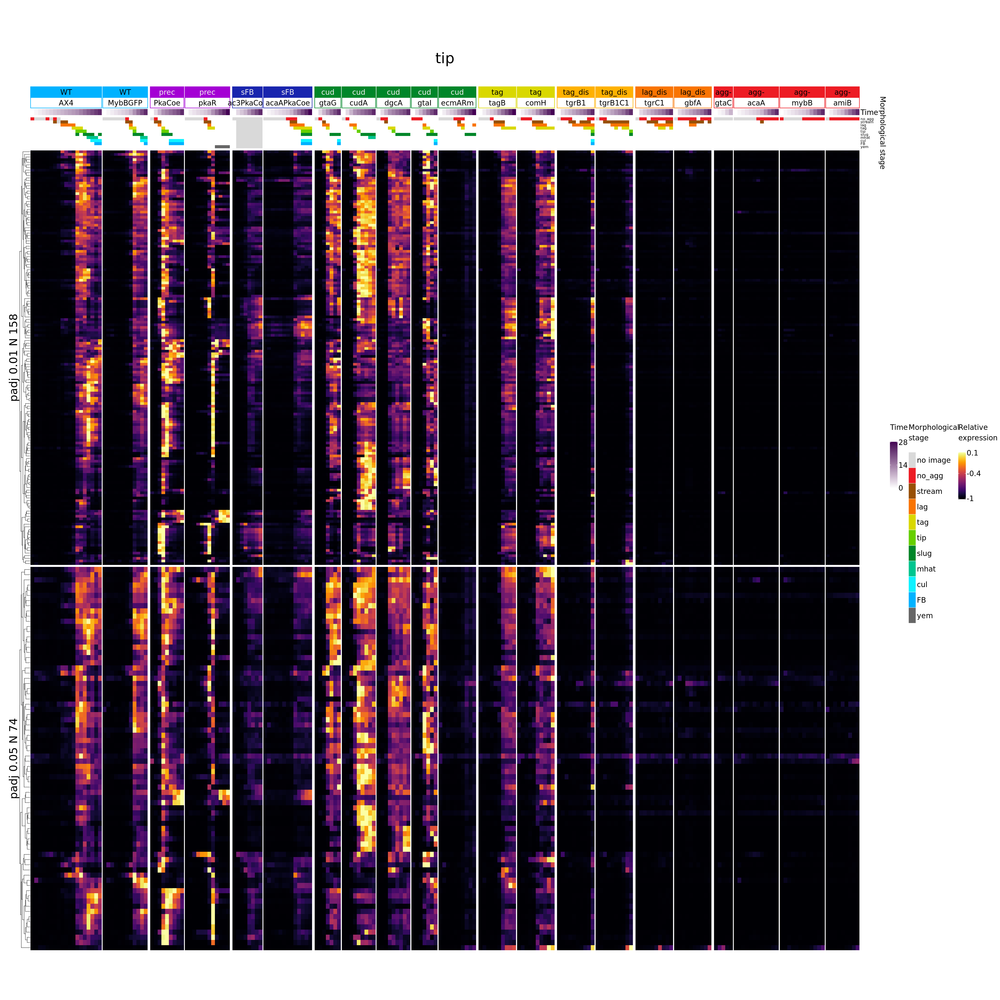

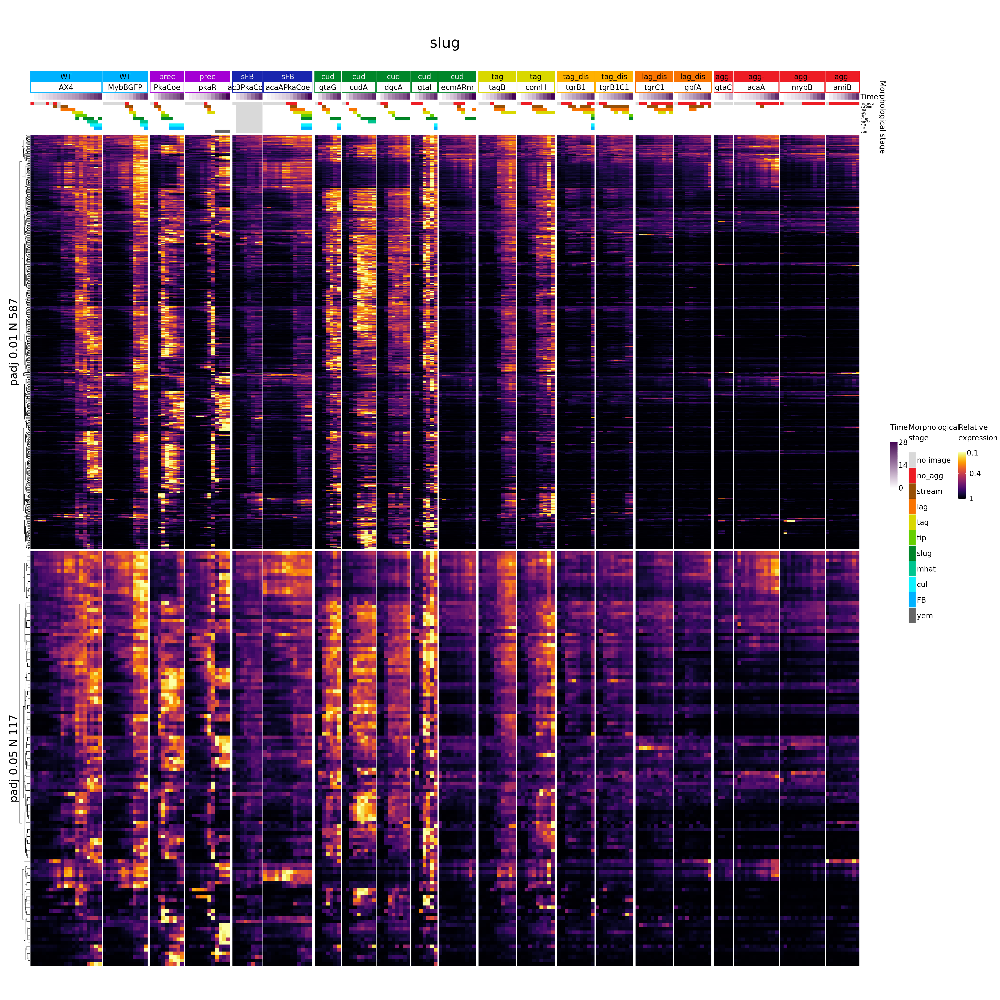

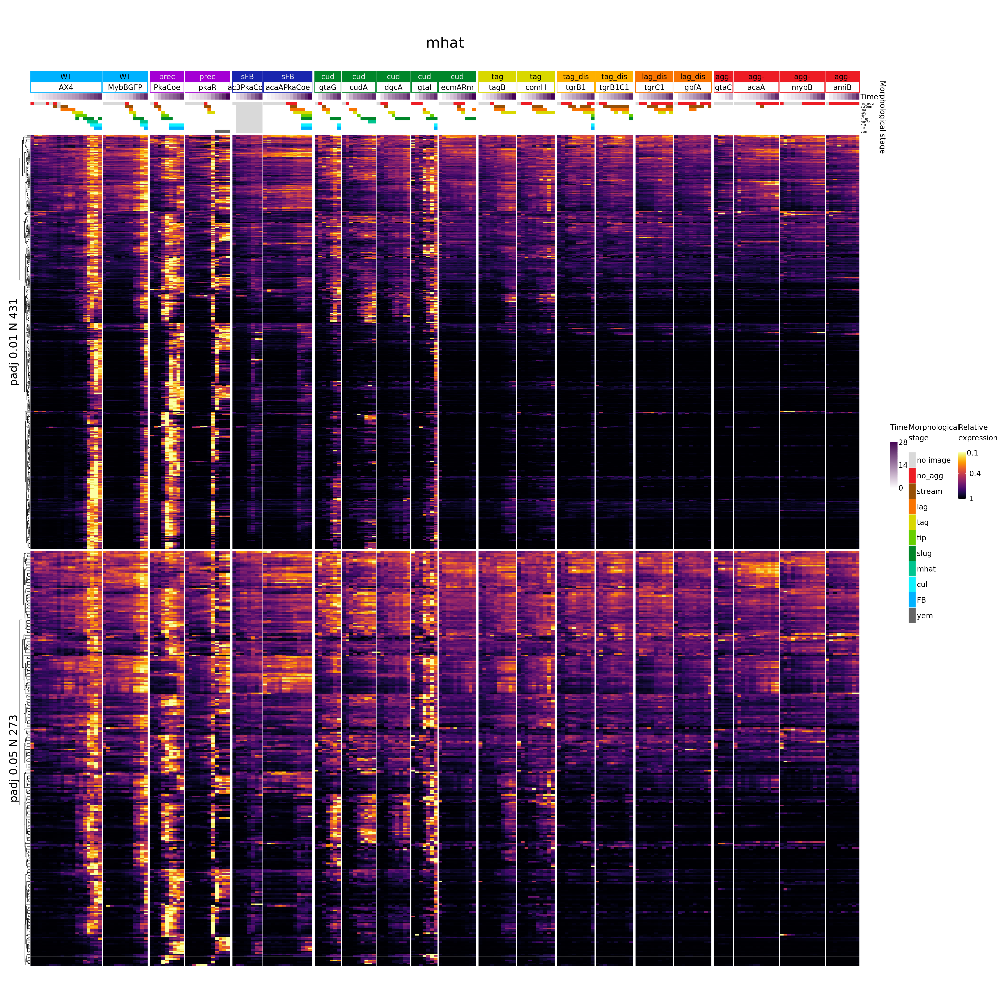

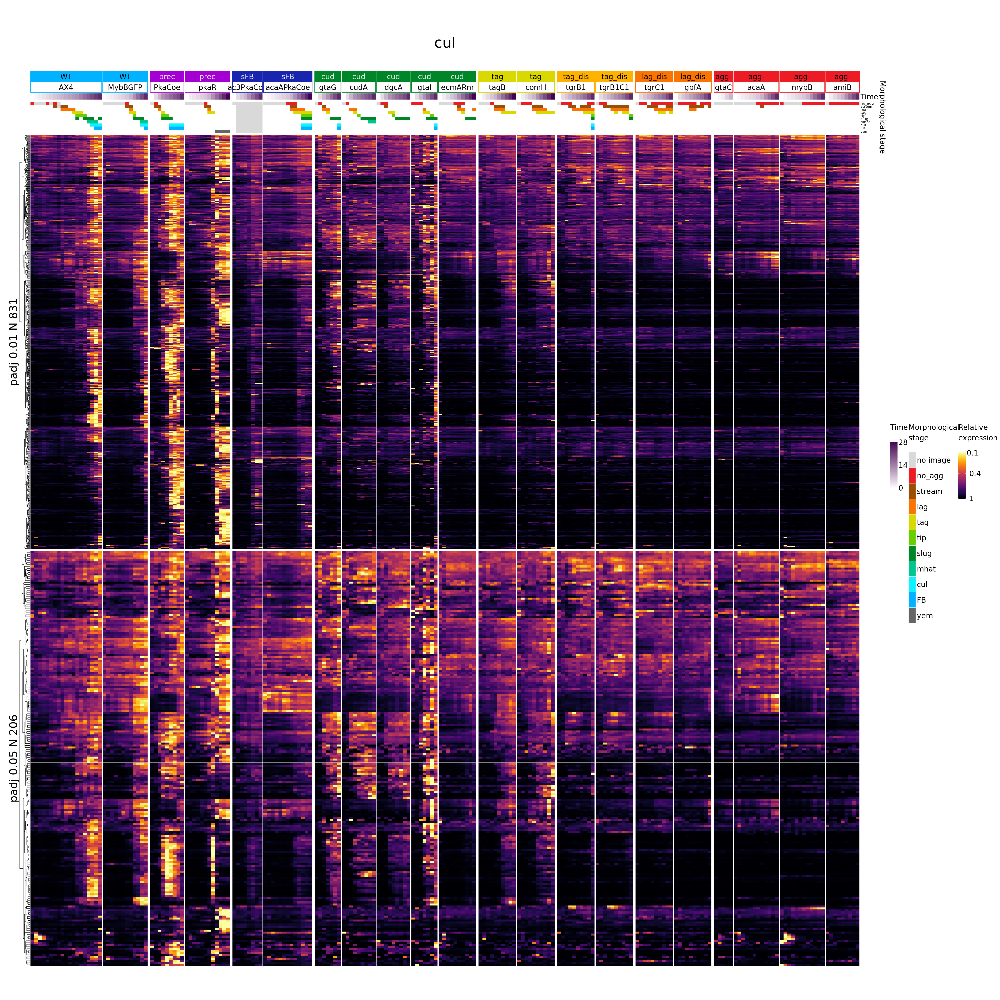

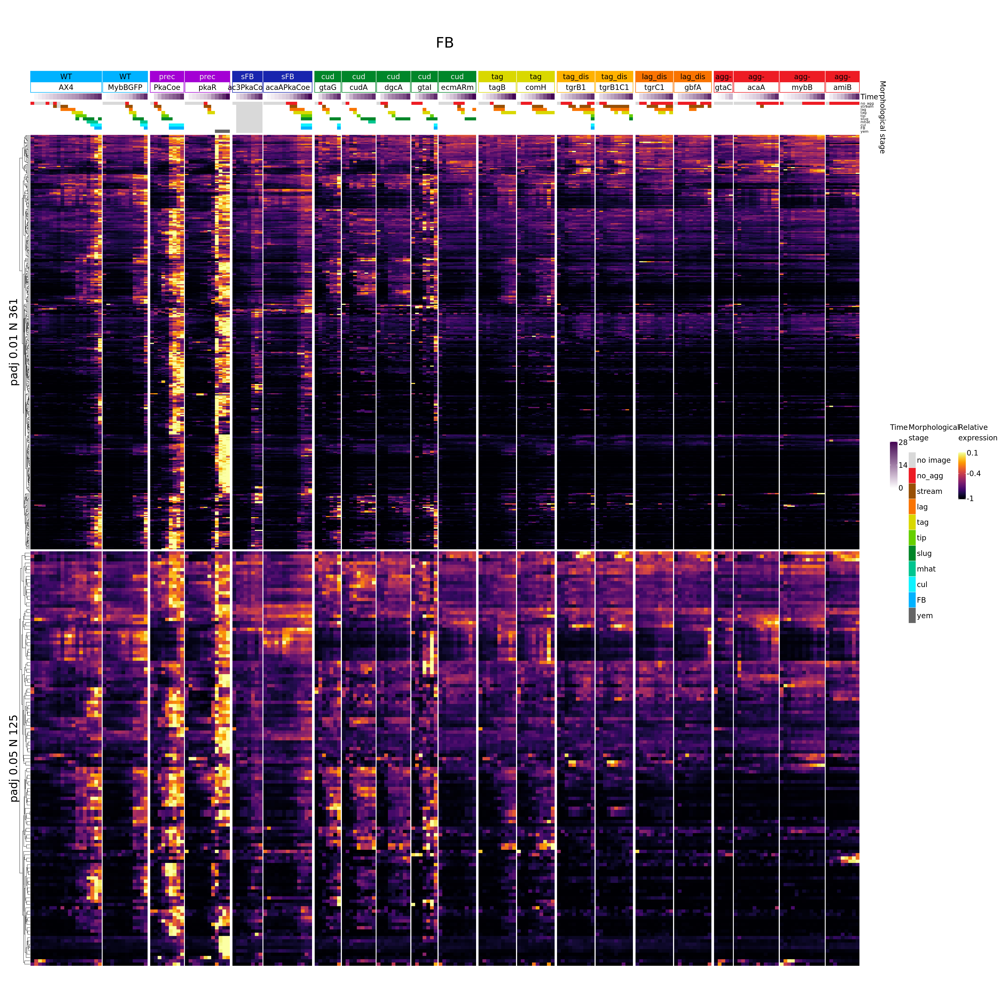

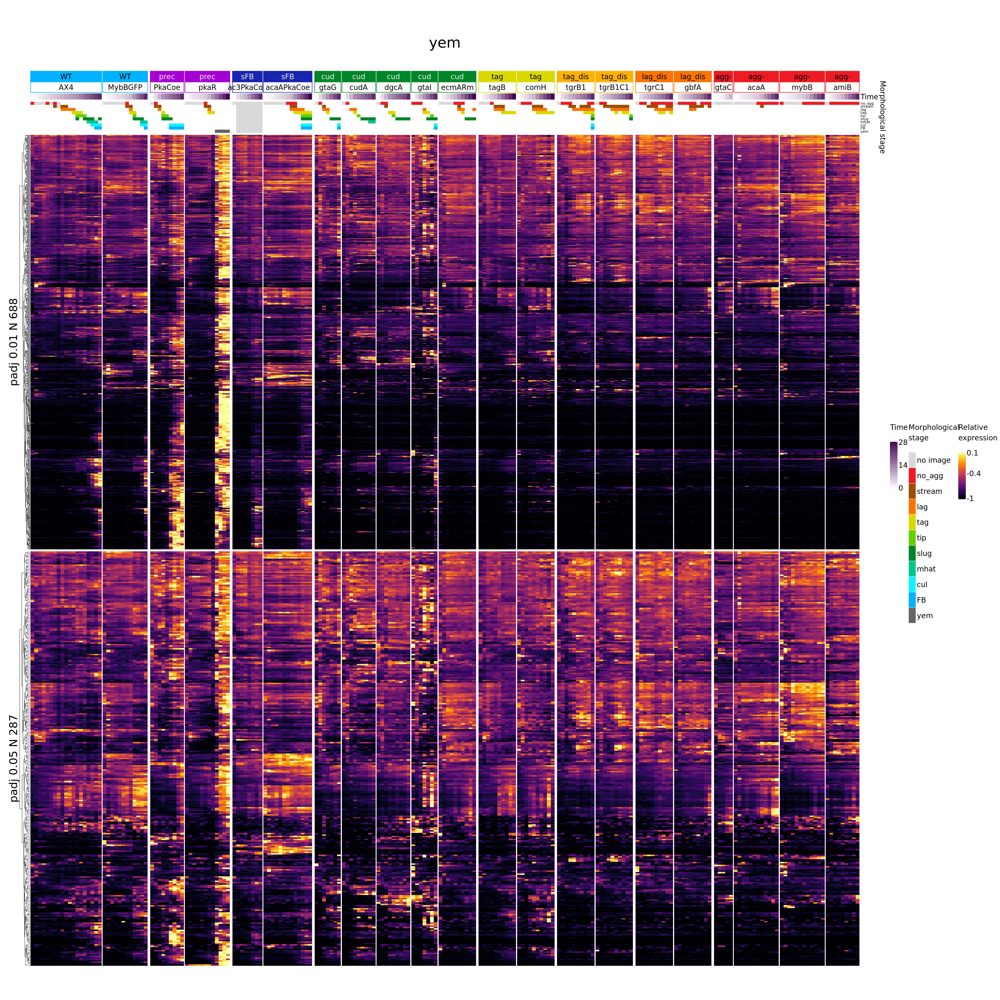

In [46]:
pvals_data<-data.frame(padj_max=c(0.01,0.05))
    for (stage in stage_order){
        #print(stage)
        if (file.exists(paste(path_de,'strain_batchrep_lFC05_upper/',stage,'_combined.tsv',sep=''))){
        data=read.table(paste(path_de,'strain_batchrep_lFC05_upper/',stage,'_combined.tsv',sep=''),
                        header=TRUE,sep='\t',row.names=1)
        data=data[!is.na(data$combined_padj),]
        first=TRUE
        heatmaps=make_anno()
        for(param_idx in 1:nrow(pvals_data)){
            padj=pvals_data[param_idx,'padj_max'] 
            
            genes<-rownames(data[data$combined_padj<=padj,])
            genes_previous=c()
            if (param_idx>1) genes_previous=rownames(data[data$combined_padj<=pvals_data[param_idx-1,'padj_max'],])
            genes<-genes[which(!genes %in% genes_previous)]
            n_genes=length(genes)
            #print(paste(padj,lfc,n_genes))
            
            data_anno=paste('padj',padj,'N',n_genes)
            height=0.5*n_genes
            if (height>40) height=40
            heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                            show_column_names = FALSE,
                              show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                              row_title=data_anno,
                              show_heatmap_legend = first,heatmap_legend_param = list(
                              title = "\nRelative \nexpression\n",
                              at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                              grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                              labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                              #** Cluster name fontsize\n",
                              row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))
            first=FALSE
            heatmaps = heatmaps %v% heatmap
        }
        draw(heatmaps,width=unit(80, "cm"),
         column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))
    }
    }

## Genes upregulated at a stage (ImpulseDE2)
ImpulseDE2 was used in hope to beter include the temporal information of the stage progression. ImpulseDE2 fits peak model to temporal data and tests if gene is differentially expressd through time. The fitted model is either S shaped (sigmoid) or peak/valley shaped (two sigmoid curves). The information about the fitted model can be extracted to approximate at which times (here stages) the gene was at up- or down-level (based on the sigmoid fit).

The model was fitted using stages as times, using a sample for each stage it was annotated. Yem stage was not used, as it has strong overexpression, masking the pattern across other stages. For all strains data the model was fitted without accounting for strains or replicates. For WT data only WT strains were used, accounting for replicate batches. Milestone genes were retrieved by first obtaining genes significantly DE across stages (ImpulseDE2 test) and then by extracting stage related genes. Stage related genes were defined as those that were at the up-level at stage and at down-level at all stages except the two neighbouring stages (to account for inprecision at determining what is at up and down level). no_agg was not treated as a neighbour of stream and vice versa, to get better separation between these two stages.

### All strains (ImpulseDE2)

In [ ]:
data=read.table(paste(path_impulse,'DEacrossStages_summary_noyem.tsv',sep=''),
                    header=TRUE,sep='\t')
stage_order_data=stage_order[stage_order %in% colnames(data)]
n_stages=length(stage_order_data)
for (stage_idx in 1:n_stages){
    stage=stage_order_data[stage_idx]
    previous_idx=stage_idx-1
    next_idx=stage_idx+1
    # Excludes no_agg from being neighbouring (assumes no_agg is first) - if not so set to <1
    if (previous_idx<2) previous_idx=NULL
    #Excludes no_agg from having neighbours
    if (next_idx>n_stages | next_idx==2) next_idx=NULL
    neighbouring=stage_order_data[c(previous_idx,next_idx)]
    #print(paste(stage,neighbouring[1],neighbouring[2]))
    not_neigh=stage_order_data[!stage_order_data %in% c(stage,neighbouring)]
    genes<-as.character((data[data[stage]=='up',] %>% filter_at(vars(not_neigh), all_vars(.=='down')))$X)
    n_genes=length(genes)
    #print(paste(stage,n_genes))

    data_anno=paste('N',n_genes)
    height=0.5*n_genes
    if (height>40) height=40
    heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                    show_column_names = FALSE,
                      show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                      row_title=data_anno,
                      show_heatmap_legend = TRUE,heatmap_legend_param = list(
                      title = "\nRelative \nexpression\n",
                      at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                      grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                      labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                      #** Cluster name fontsize
                      row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))

    draw(make_anno() %v% heatmap,width=unit(80, "cm"),
        column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))

}

### WT (ImpulseDE2)

In [ ]:
data=read.table(paste(path_impulse,'DEacrossStages_summary_WT_noyem_batchrep.tsv',sep=''),
                    header=TRUE,sep='\t')
stage_order_data=stage_order[stage_order %in% colnames(data)]
n_stages=length(stage_order_data)
for (stage_idx in 1:n_stages){
    stage=stage_order_data[stage_idx]
    previous_idx=stage_idx-1
    next_idx=stage_idx+1
    # Excludes no_agg from being neighbouring (assumes no_agg is first) - if not so set to <1
    if (previous_idx<2) previous_idx=NULL
    #Excludes no_agg from having neighbours
    if (next_idx>n_stages | next_idx==2) next_idx=NULL
    neighbouring=stage_order_data[c(previous_idx,next_idx)]
    #print(paste(stage,neighbouring[1],neighbouring[2]))
    not_neigh=stage_order_data[!stage_order_data %in% c(stage,neighbouring)]
    genes<-as.character((data[data[stage]=='up',] %>% filter_at(vars(not_neigh), all_vars(.=='down')))$X)
    n_genes=length(genes)
    #print(paste(stage,n_genes))

    data_anno=paste('N',n_genes)
    if (n_genes>0){
    height=0.5*n_genes
    if (height>40) height=40
    heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                    show_column_names = FALSE,
                      show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                      row_title=data_anno,
                      show_heatmap_legend = TRUE,heatmap_legend_param = list(
                      title = "\nRelative \nexpression\n",
                      at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                      grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                      labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                      #** Cluster name fontsize
                      row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))

    draw(make_anno() %v% heatmap,width=unit(80, "cm"),
        column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))
    }else{
        print(paste('No genes selected for',stage))
    }

}

## Classification
One vs rest logistic regression classifier was trained on the stages data. For each classifier (e.g. for each stage) features (genes) with positive weights (upregulated at a stage) were selected at different l1 regularisation thresholds. The heatmaps show expression of the genes that staied in the model at different regularsiation thresholds (writted as row block names on the left). Genes selected at both lower and higher regularisation threshold were excluded from plotting in the higher regularisation row block. Lower regularisation constant results in more stringent regularisation.

Genes selected by classification are selected so that they predict the stage in combination. Namely, an individual gene may not be upregulated/peaking at the target stage in all strains. Thus different upregulated gene combinations can be responsible for a positive prediction in different strains. Additionally, the model also included genes with negative weights (e.g. downregulated). Thus a combination of positive and negative weight genes is in fact required for a good prediction. 

In [284]:
data=vector(mode = "list", length = 4)
names(data)<-as.character(c(0.1,0.2,0.3,0.8))
for (c in names(data)){
    data[[c]]=t(read.table(paste(path_classification,'selectedPositiveFeatures_c',c,'.tsv',sep=''),
                    header=TRUE,sep='\t',row.names=1))
}

In [ ]:
for (stage in stage_order[stage_order %in% colnames(data[[1]])]){
    #print(stage)
    
    genes_previous=c()
    first=TRUE
    heatmaps=make_anno()
    for(c in names(data)){
        data_c=data[[c]]
        genes<-rownames(data_c[data_c[,stage]==1,])
        genes<-genes[which(!genes %in% genes_previous)]
        genes_previous<-union(genes_previous,genes)
        n_genes=length(genes)
        #print(paste(padj,lfc,n_genes))
        
        data_anno=paste('C',c,'N',n_genes)
        height=0.5*n_genes
        if (height>20) height=20
        heatmap=Heatmap(t(avg_expression[,genes]),cluster_columns = FALSE,cluster_rows = TRUE,
                        show_column_names = FALSE,
                          show_row_names = FALSE, col=inferno(256),column_title=NULL, 
                          row_title=data_anno,
                          show_heatmap_legend = first,heatmap_legend_param = list(
                          title = "\nRelative \nexpression\n",
                          at = c(min_expression, round(mean(c(min_expression,max_expression)),1),max_expression),
                          grid_width= unit(legend_width, "cm"),grid_height= unit(legened_height, "cm") ,
                          labels_gp = gpar(fontsize = cluster_font),title_gp = gpar(fontsize = cluster_font)),
                          #** Cluster name fontsize
                          row_title_gp=gpar(fontsize=cluster_font*1.5),height=unit(height, "cm"))
        first=FALSE
        heatmaps = heatmaps %v% heatmap
    }
    draw(heatmaps,width=unit(80, "cm"),
     column_title =paste(stage,'\n'),column_title_gp = gpar(fontsize = cluster_font*2))

}

## Challenges
- Samples have multiple stages. This is probably the reason that many of the milestone genes overlap across stages.
- Stages are ordered in time - performing simple DE analysis (one stage vs rest) does not account for this. We also have different number of samples from each stage in the reference. Thus the chosen stage-upregulated genes may not separate neighbouring stages. Another option would be to compare each stage to another stage and see what is upregulated at every comparison of a particluar stage to each of the other stages. However, this is problematic as most samples have overlapping stages.
- Accounting for batch effects due to different replicates/strains is problematic: 1.) Most replicates do not progress through all stages so  replicate batch size factors may not be appropriate. 2.) Batches (e.g. strains or replicates) do not differ only in expression strength but also expression pattern through stages. One option to account for these issues is to use only WT data, but this disregards information from the majority of samples (non-WT).